In [16]:
! pip install -r https://raw.githubusercontent.com/ultralytics/yolov5/master/requirements.txt > /dev/null
! pip install git+https://github.com/openai/CLIP.git > /dev/null

The system cannot find the path specified.


The system cannot find the path specified.


In [25]:
%matplotlib inline
import matplotlib.pyplot as plt
from glob import glob
from PIL import Image
import numpy as np
import torch
import clip
import cv2
import os

## **Object Detection**

In [26]:
def objectDetection(img_path:str, model) -> list:
    image = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
    image_name = os.path.basename(img_path)
    image_name = image_name.split('.')[0]

    result = model(image)
    result.crop(save_dir=os.path.join("YOLO", image_name))
    detectedObjects = result.render()[0]
    path = os.path.join("YOLO", image_name, 'crops', '**', '*.jpg')

    listOfObjects = []
    for filename in glob(path):
        obj = cv2.cvtColor(cv2.imread(filename), cv2.COLOR_BGR2RGB)
        listOfObjects.append(obj)     

    return listOfObjects, detectedObjects

## **Find Objects**

In [27]:
def similarity_top(similarity_list:list, listOfObjects:list, N) -> tuple():
    results = zip(range(len(similarity_list)), similarity_list)
    results = sorted(results, key=lambda x: x[1], reverse=True)
    images = []
    scores=[]
    for index, score in results[:N]:
        scores.append(score)
        images.append(listOfObjects[index])

    return scores, images


def findObjects(listOfObjects:list, query:str, model, preprocess, device:str, N) -> tuple():
    objects = torch.stack([preprocess(Image.fromarray(im)) for im in listOfObjects]).to(device)

    with torch.no_grad():
        image_features = model.encode_image(objects)
        image_features /= image_features.norm(dim=-1, keepdim=True)

        text_features = model.encode_text(clip.tokenize(query).to(device))
        text_features /= text_features.norm(dim=-1, keepdim=True)

    similarity = (text_features.cpu().numpy() @ image_features.cpu().numpy().T) * 100
    similarity = similarity[0]
    scores, images = similarity_top(similarity, listOfObjects, N=N)     

    return scores, images

## **Util Functions**

In [28]:
def plotResults(scores:list, images:list, n):
    plt.figure(figsize=(20,5))
    for index, img in enumerate(images):
        plt.subplot(1,n, index+1)
        plt.imshow(img)
        plt.title(scores[index])
        plt.axis('off')
    plt.show()

## **Create Pipeline**

### Configs

In [29]:
OBJDETECTIONMODEL = 'yolov5x6'
OBJDETECTIONREPO = 'ultralytics/yolov5'
FINDERMODEL = 'ViT-B/32'
DEVICE = 'cpu'
N = 5

### Define Models

In [30]:
objectDetectorModel = torch.hub.load(OBJDETECTIONREPO, OBJDETECTIONMODEL)
objectFinderModel , preProcess = clip.load(FINDERMODEL, device=DEVICE)
# Available Models:
# ['RN50',
#  'RN101',
#  'RN50x4',
#  'RN50x16',
#  'RN50x64',
#  'ViT-B/32',
#  'ViT-B/16',
#  'ViT-L/14',
#  'ViT-L/14@336px']

Using cache found in C:\Users\prath/.cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2024-2-8 Python-3.9.18 torch-2.1.2+cpu CPU

Fusing layers... 
YOLOv5x6 summary: 574 layers, 140730220 parameters, 0 gradients, 209.6 GFLOPs
Adding AutoShape... 


### Final Step

In [31]:
def pipeline(image, query):
    listOfObjects, detectedObjects = objectDetection(image, objectDetectorModel)
    scores, images = findObjects(listOfObjects, query, objectFinderModel, preProcess, DEVICE, N)
    plt.figure(figsize=(20,5))
    plt.axis('off')
    plt.imshow(detectedObjects)
    plotResults(scores, images, N)

## **Now, Test on your image!**

Saved 1 image to YOLO\seq_000001
Saved results to YOLO\seq_000001



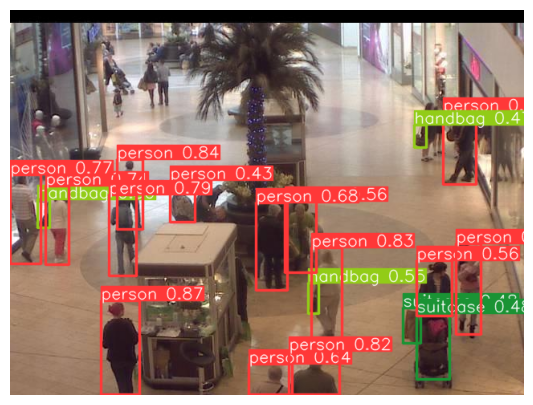

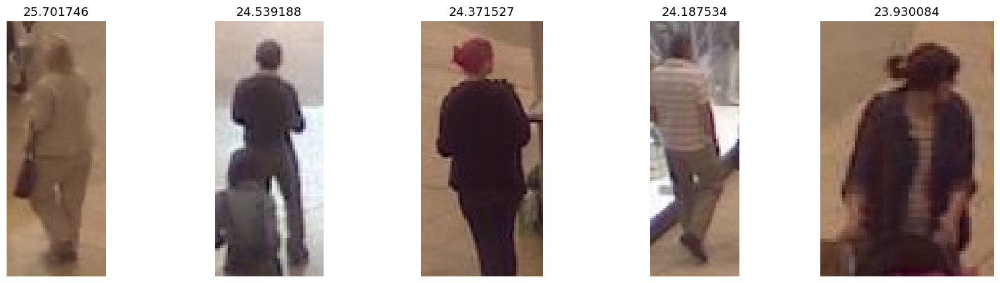

Saved 1 image to YOLO\seq_000002
Saved results to YOLO\seq_000002



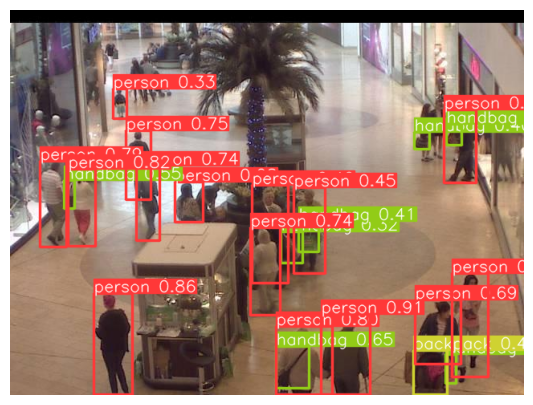

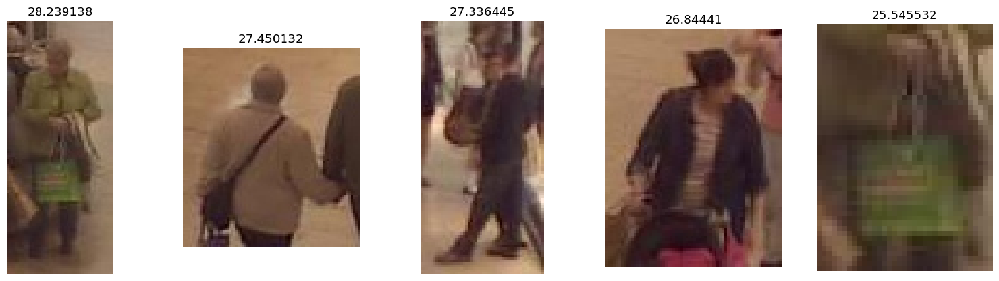

Saved 1 image to YOLO\seq_000003
Saved results to YOLO\seq_000003



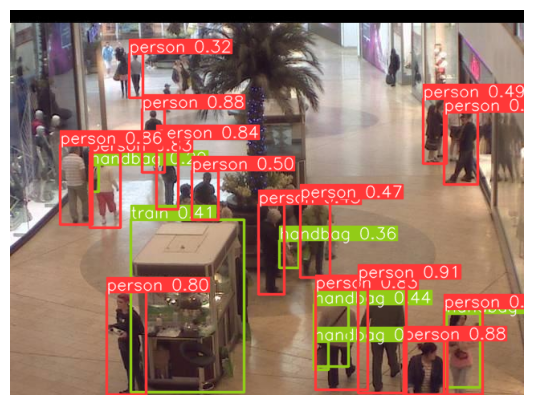

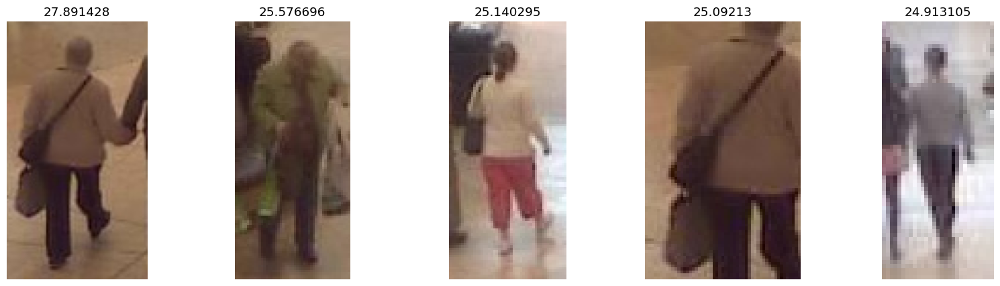

Saved 1 image to YOLO\seq_000004
Saved results to YOLO\seq_000004



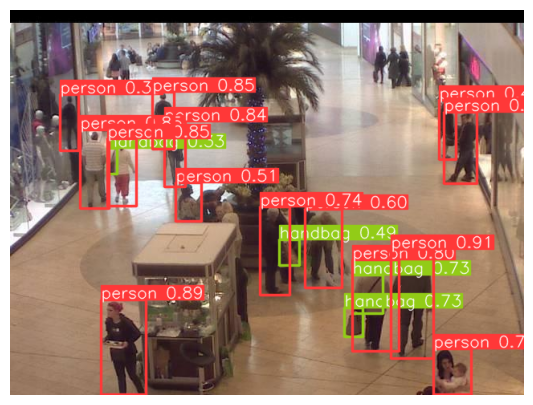

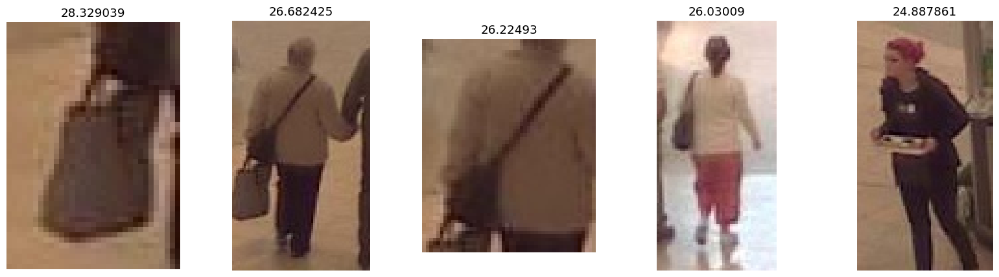

Saved 1 image to YOLO\seq_000005
Saved results to YOLO\seq_000005



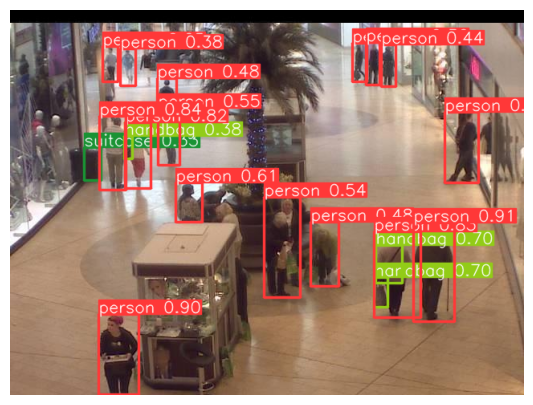

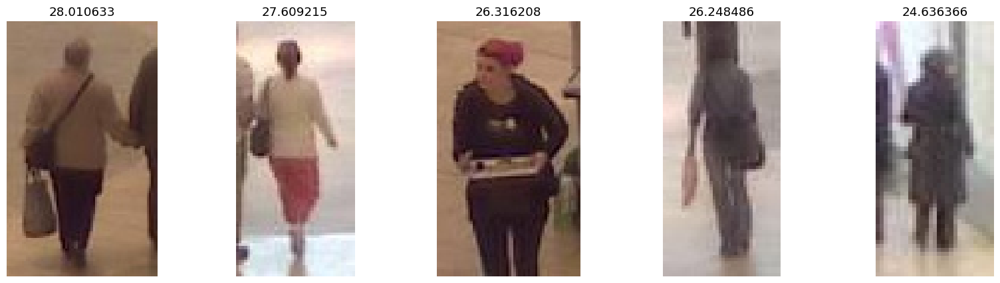

Saved 1 image to YOLO\seq_000006
Saved results to YOLO\seq_000006



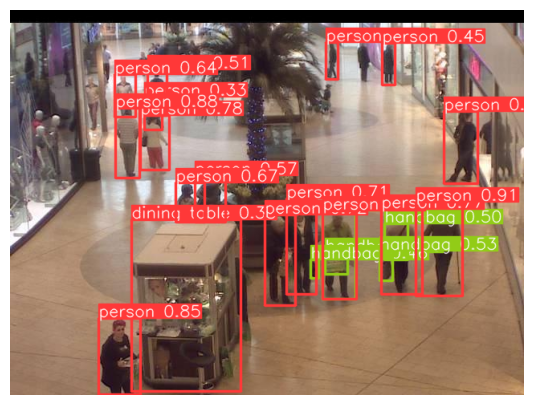

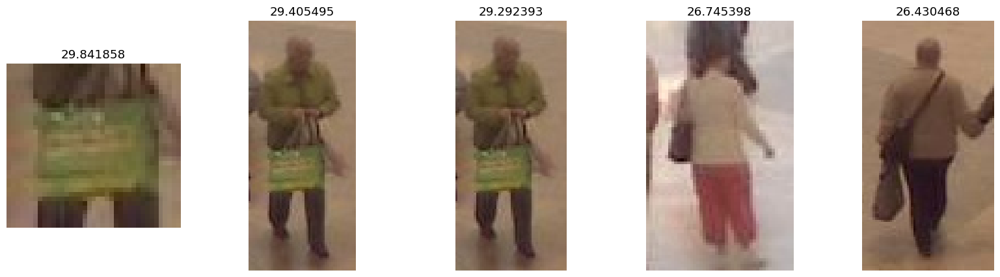

Saved 1 image to YOLO\seq_000007
Saved results to YOLO\seq_000007



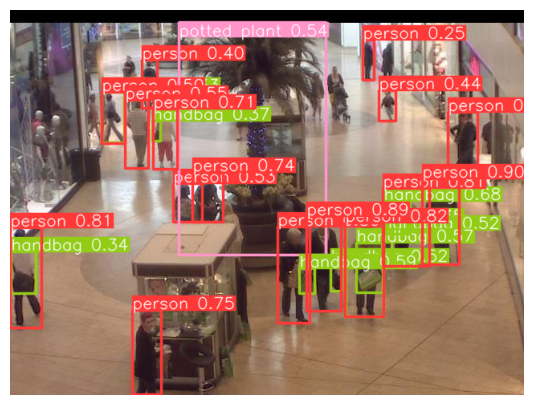

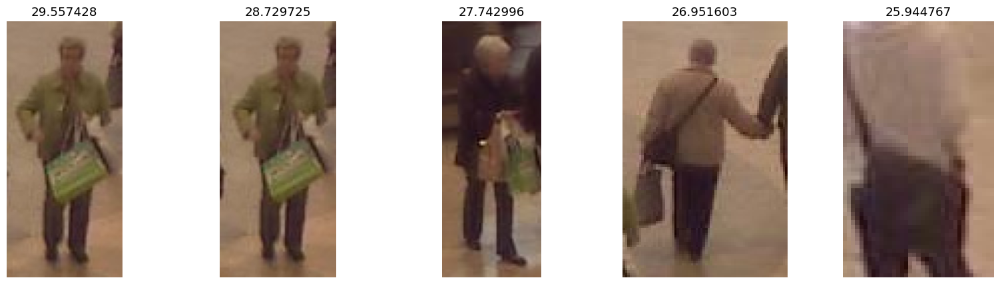

Saved 1 image to YOLO\seq_000008
Saved results to YOLO\seq_000008



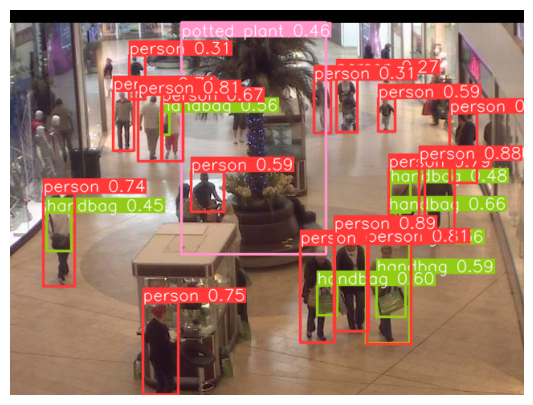

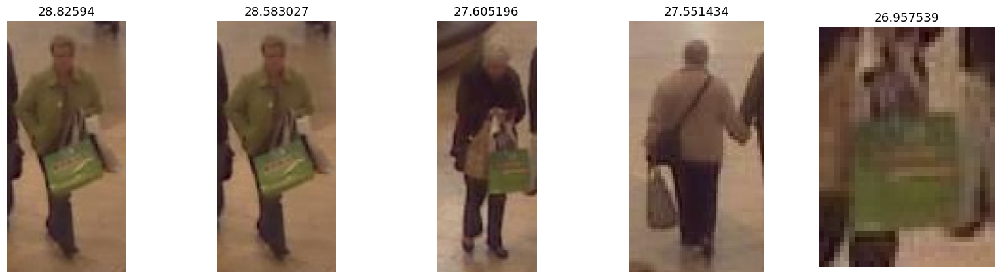

Saved 1 image to YOLO\seq_000009
Saved results to YOLO\seq_000009



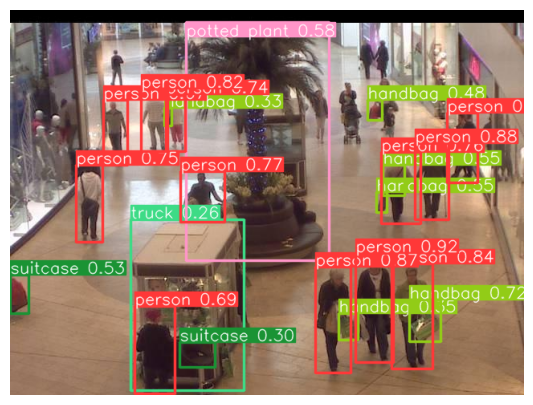

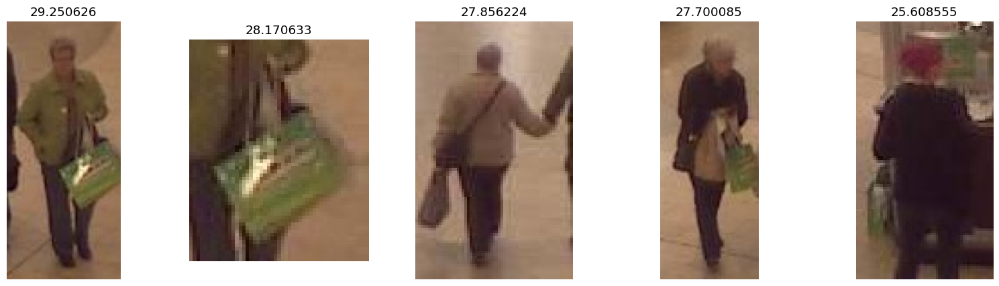

Saved 1 image to YOLO\seq_000010
Saved results to YOLO\seq_000010



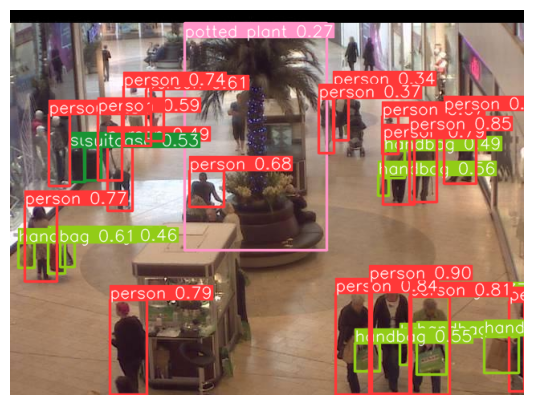

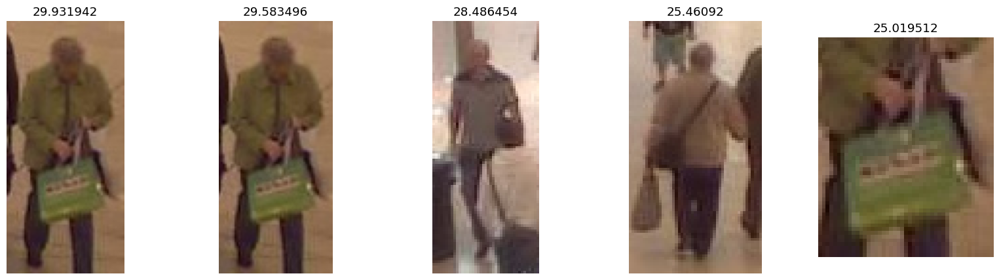

In [32]:
folder_path="frames"

for filename in os.listdir(folder_path):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(folder_path, filename)
        pipeline(image_path, 'human with green handbag')

Saved 1 image to YOLO\seq_0000012
Saved results to YOLO\seq_0000012



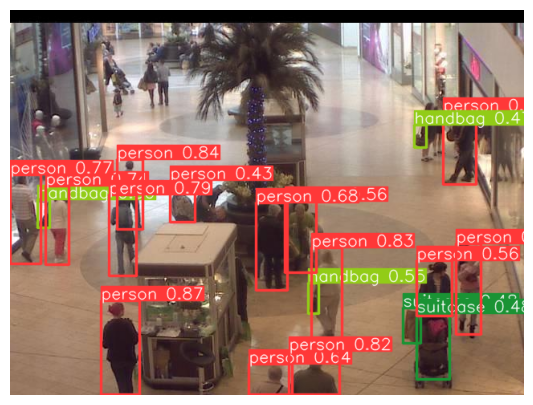

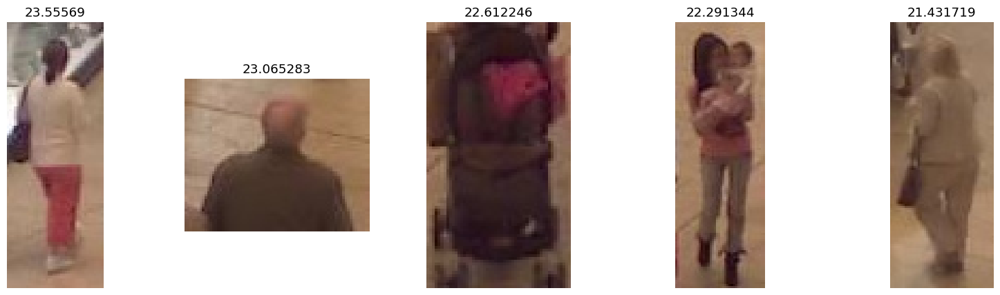

Saved 1 image to YOLO\seq_0000022
Saved results to YOLO\seq_0000022



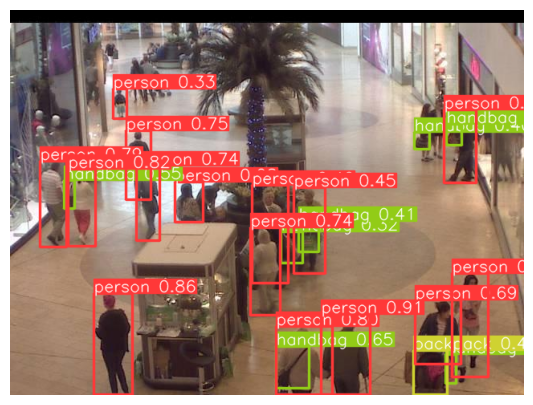

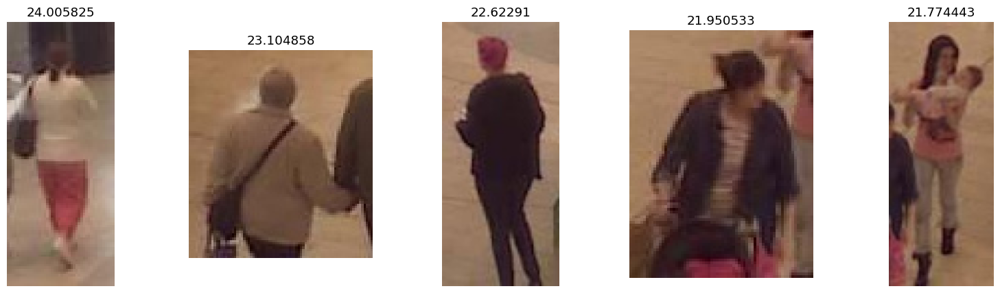

Saved 1 image to YOLO\seq_0000032
Saved results to YOLO\seq_0000032



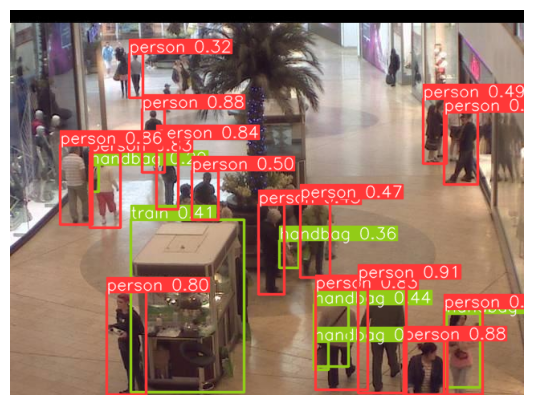

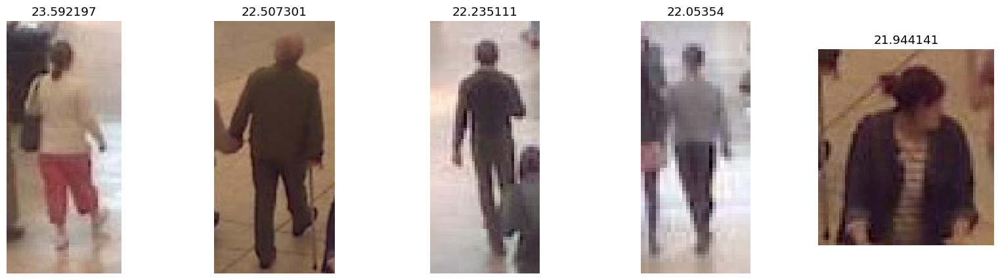

Saved 1 image to YOLO\seq_0000042
Saved results to YOLO\seq_0000042



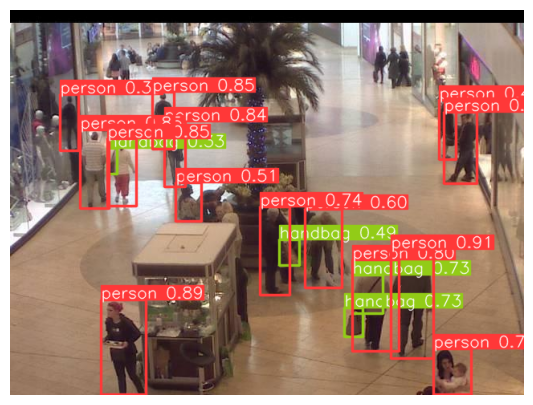

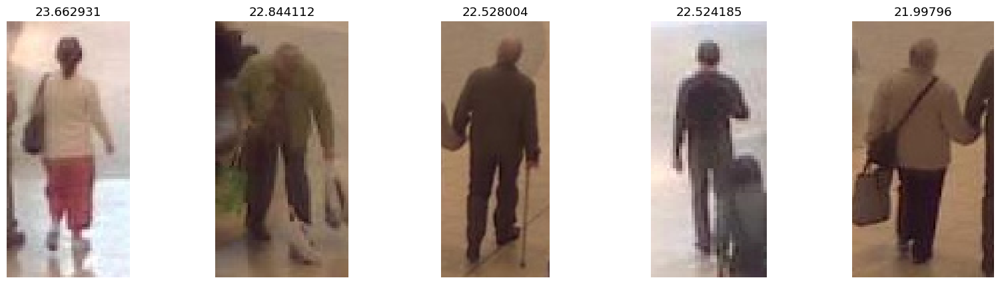

Saved 1 image to YOLO\seq_0000052
Saved results to YOLO\seq_0000052



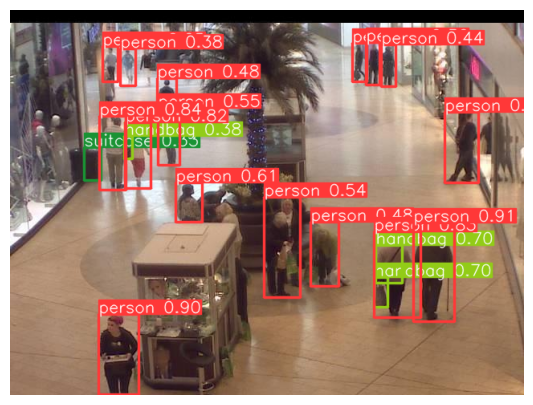

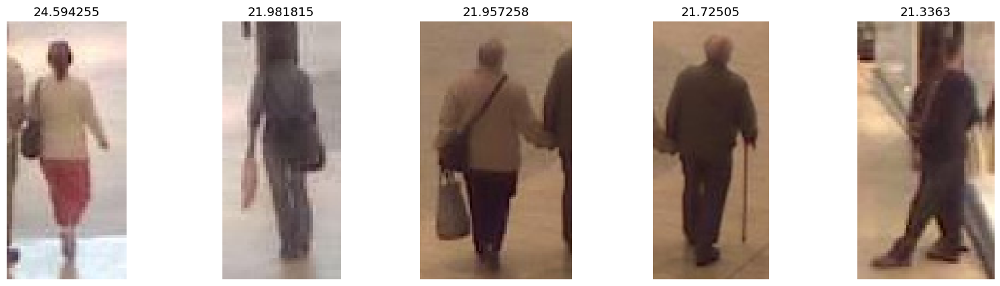

Saved 1 image to YOLO\seq_0000062
Saved results to YOLO\seq_0000062



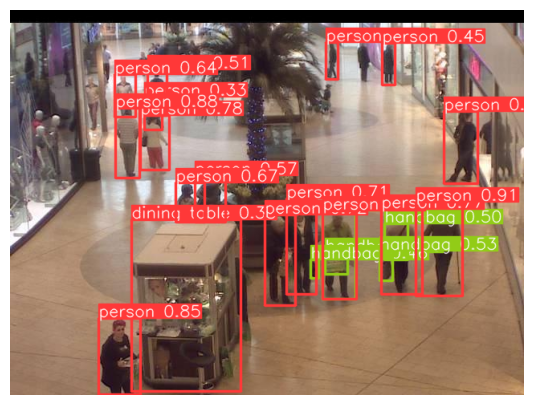

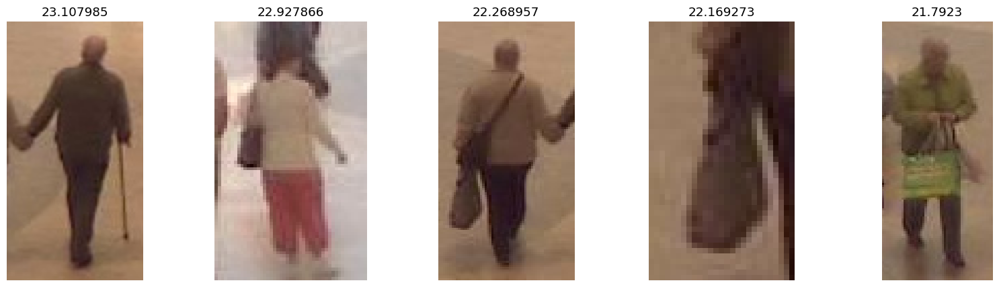

Saved 1 image to YOLO\seq_0000072
Saved results to YOLO\seq_0000072



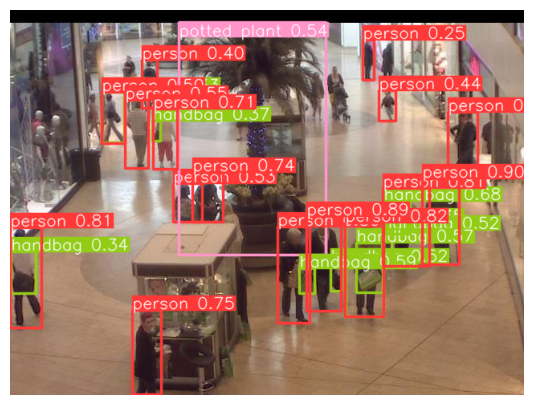

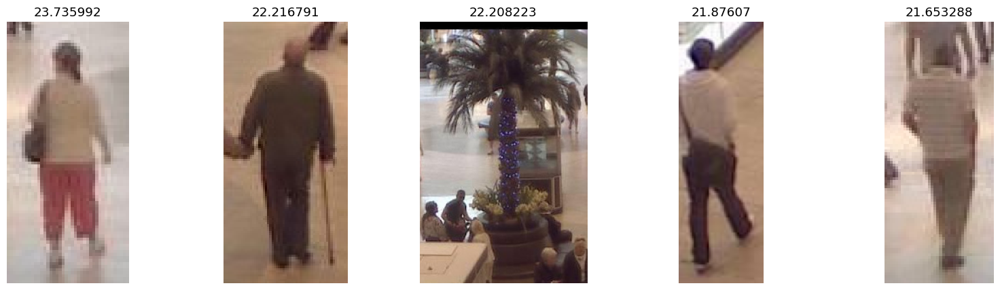

Saved 1 image to YOLO\seq_0000082
Saved results to YOLO\seq_0000082



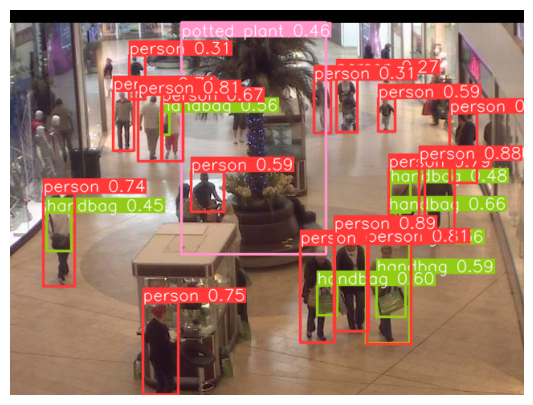

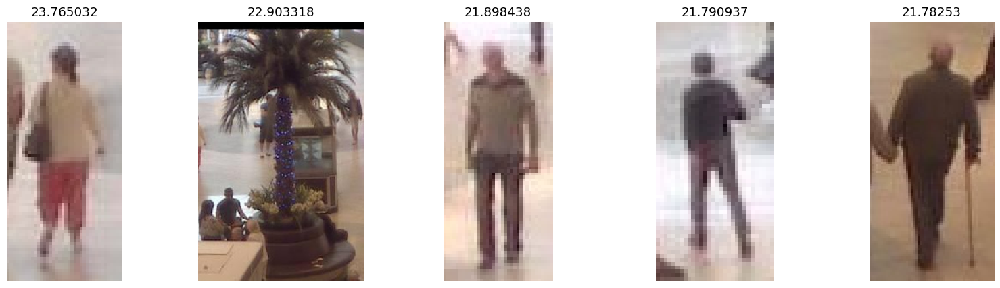

Saved 1 image to YOLO\seq_0000092
Saved results to YOLO\seq_0000092



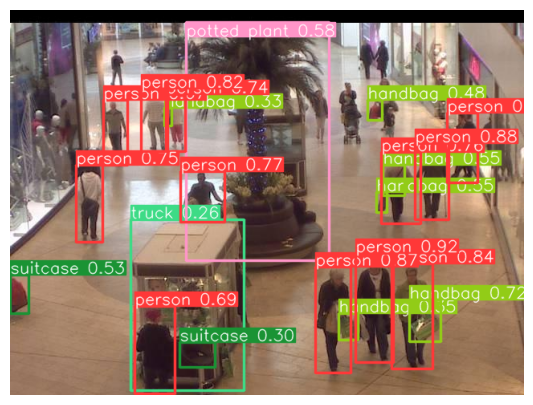

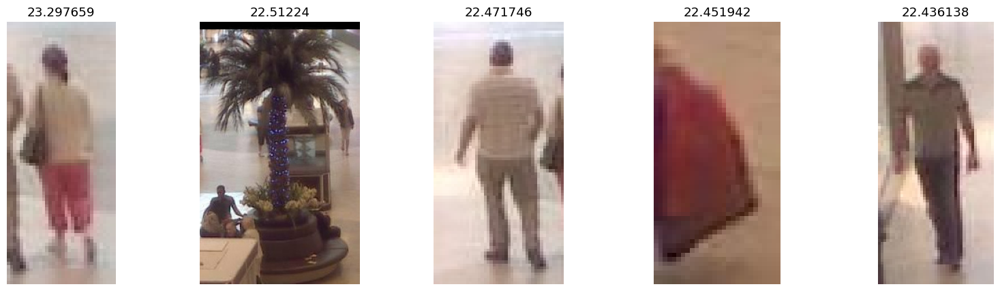

Saved 1 image to YOLO\seq_0000102
Saved results to YOLO\seq_0000102



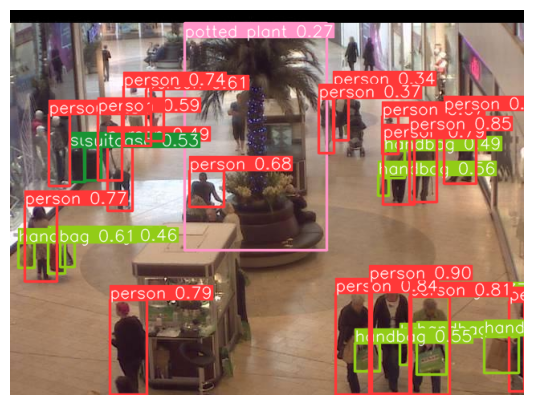

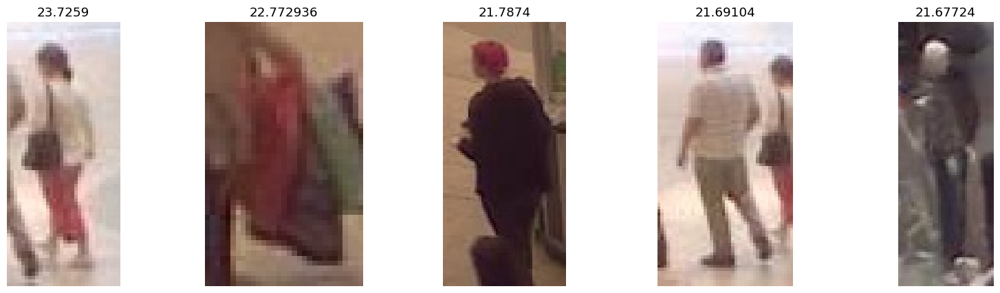

In [34]:
folder_path="frames"

for filename in os.listdir(folder_path):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(folder_path, filename)
        pipeline(image_path, 'human with red lowers')

Saved 1 image to YOLO\frame120
Saved results to YOLO\frame120



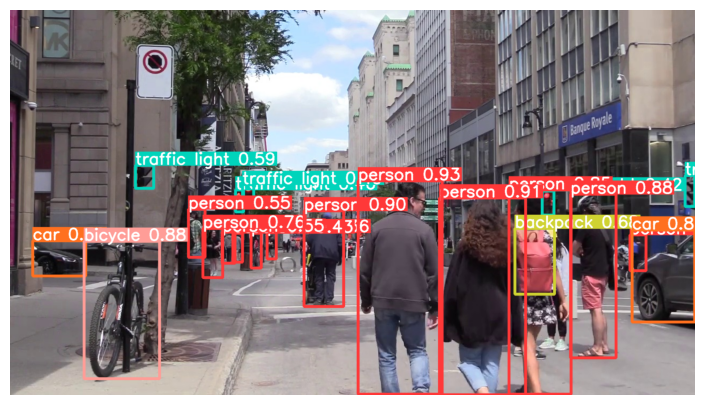

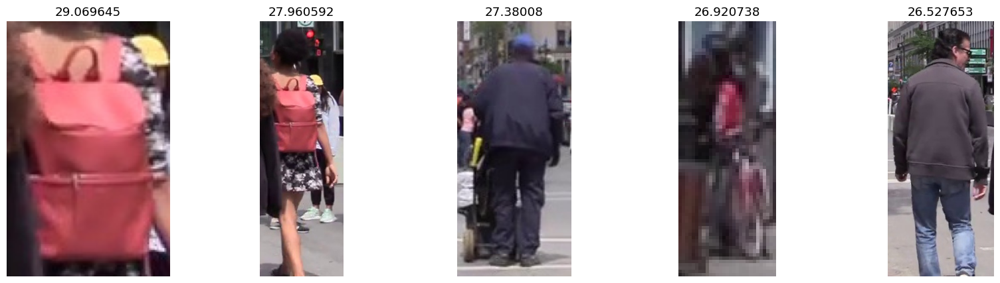

Saved 1 image to YOLO\frame180
Saved results to YOLO\frame180



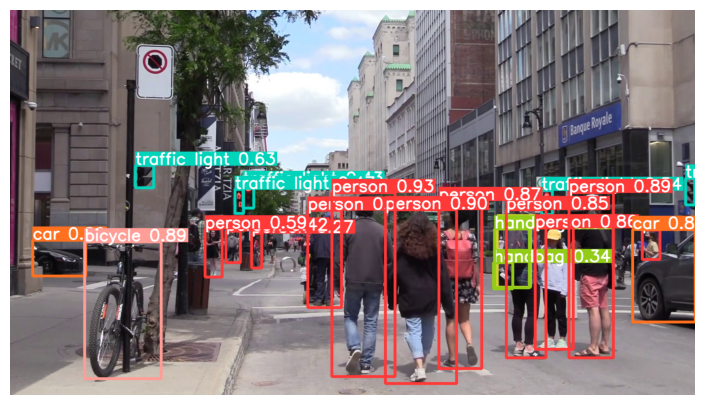

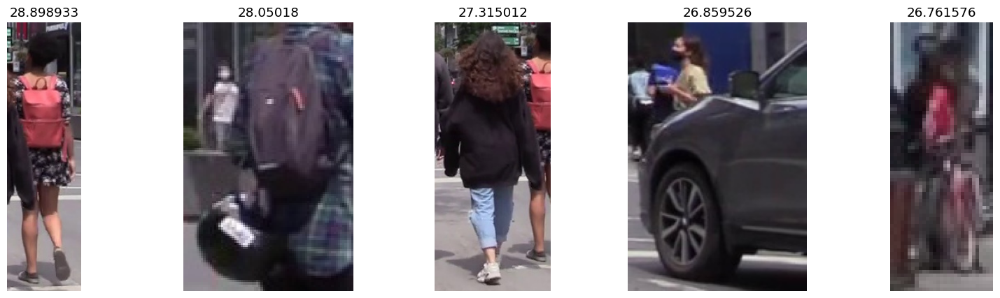

Saved 1 image to YOLO\frame240
Saved results to YOLO\frame240



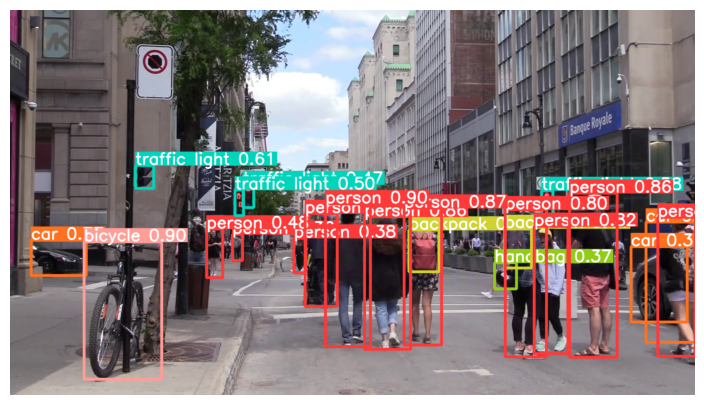

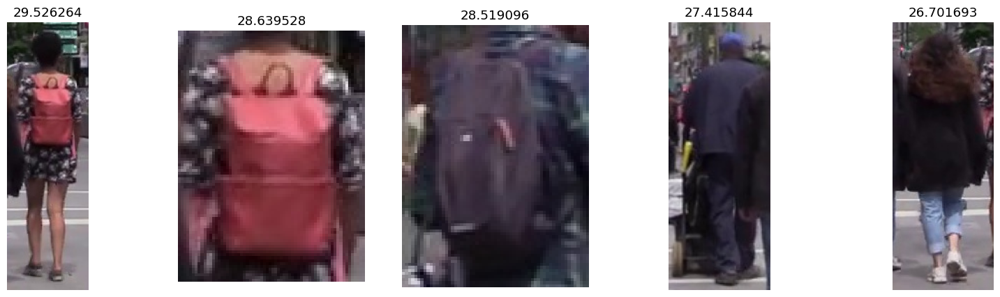

Saved 1 image to YOLO\frame300
Saved results to YOLO\frame300



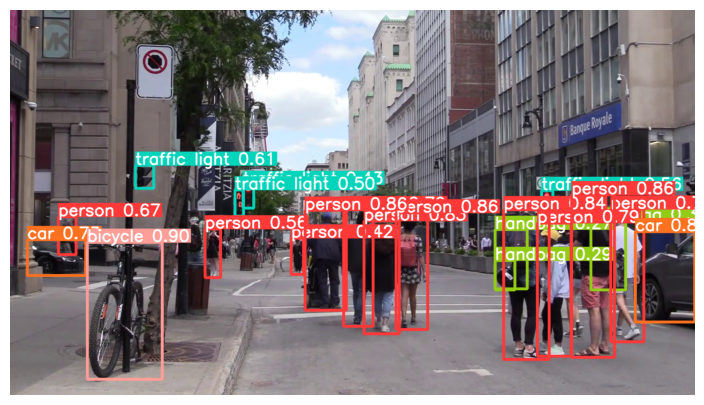

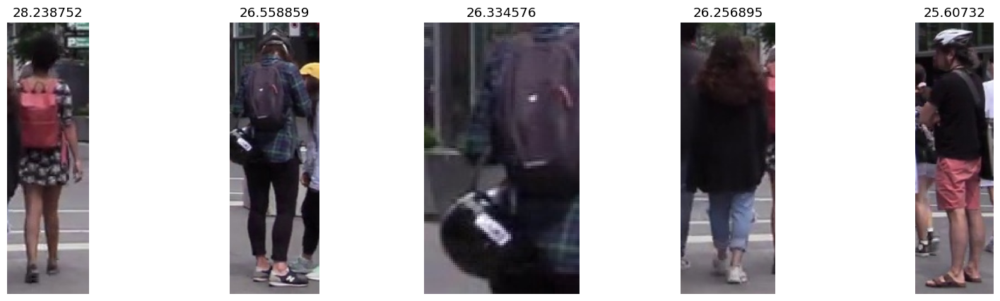

Saved 1 image to YOLO\frame360
Saved results to YOLO\frame360



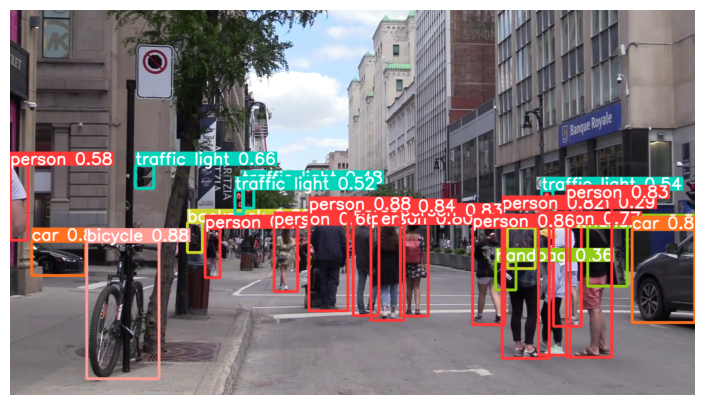

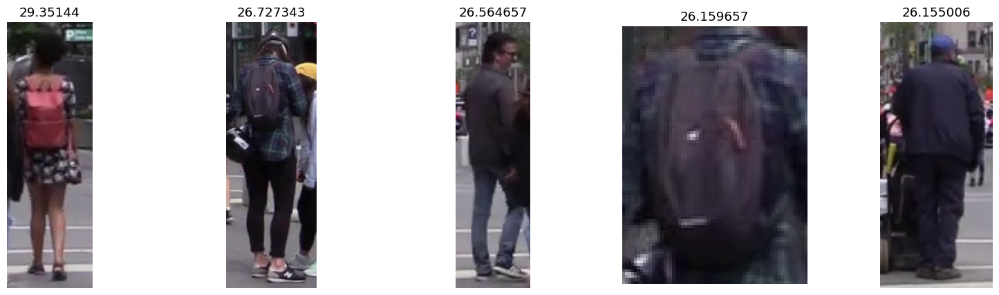

Saved 1 image to YOLO\frame420
Saved results to YOLO\frame420



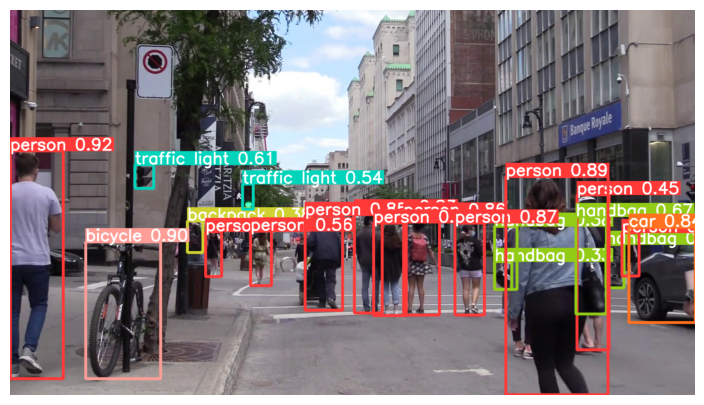

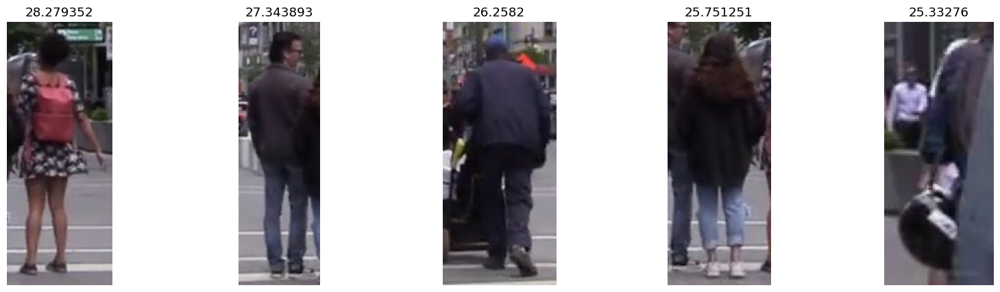

Saved 1 image to YOLO\frame480
Saved results to YOLO\frame480



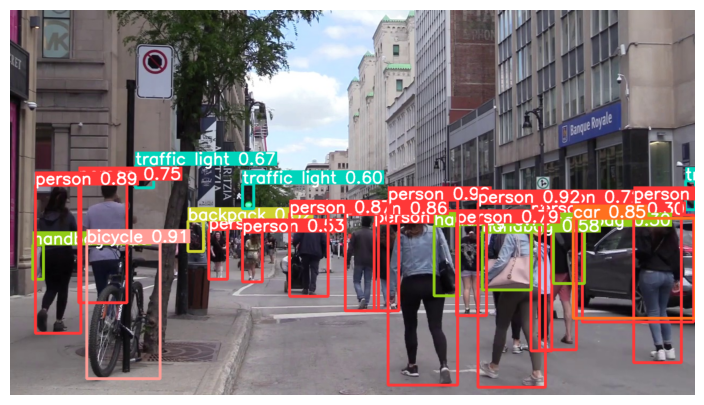

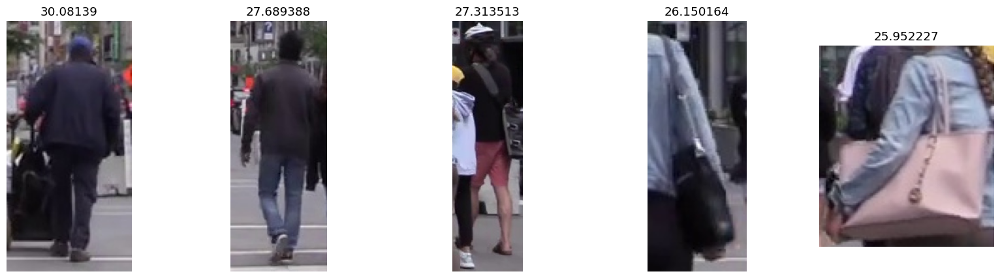

Saved 1 image to YOLO\frame540
Saved results to YOLO\frame540



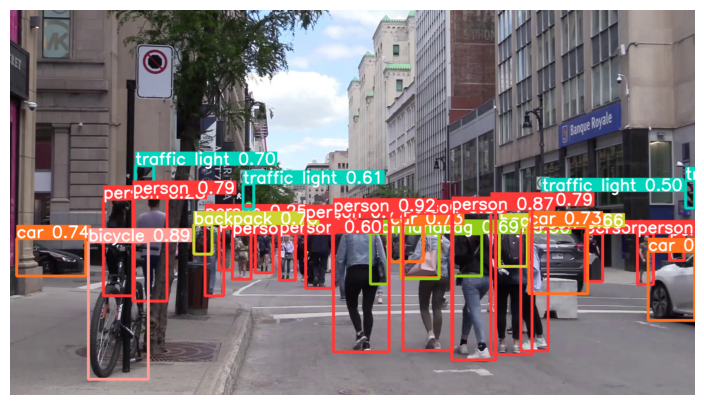

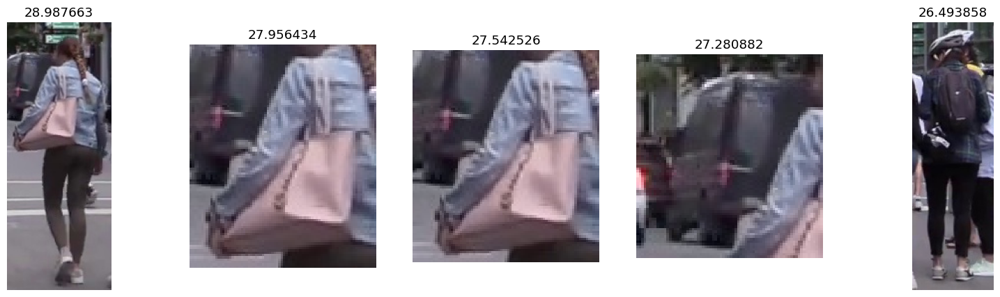

Saved 1 image to YOLO\frame60
Saved results to YOLO\frame60



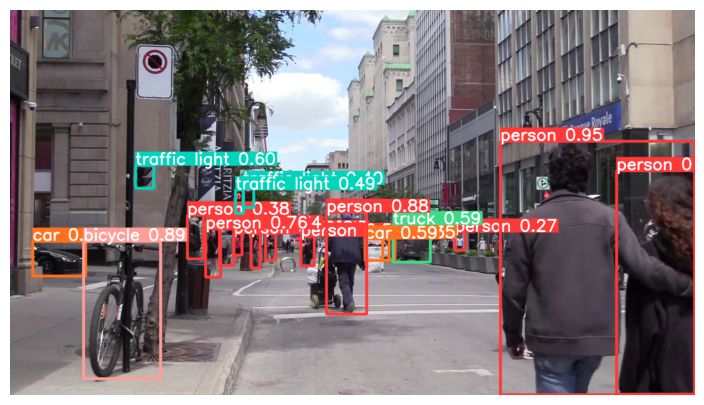

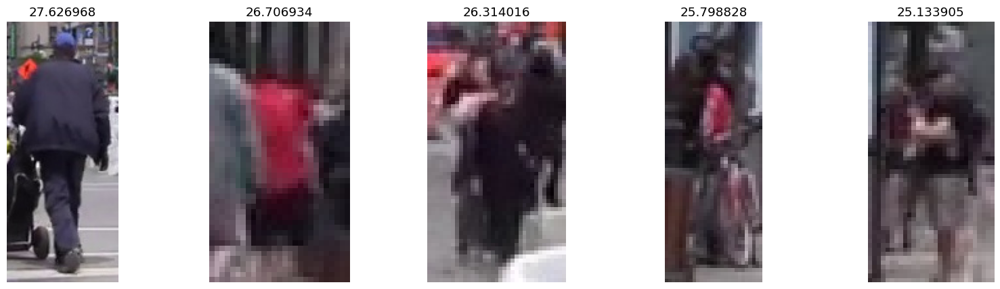

Saved 1 image to YOLO\frame600
Saved results to YOLO\frame600



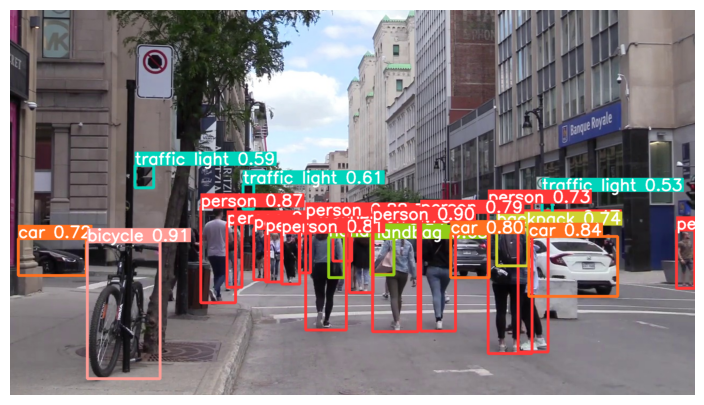

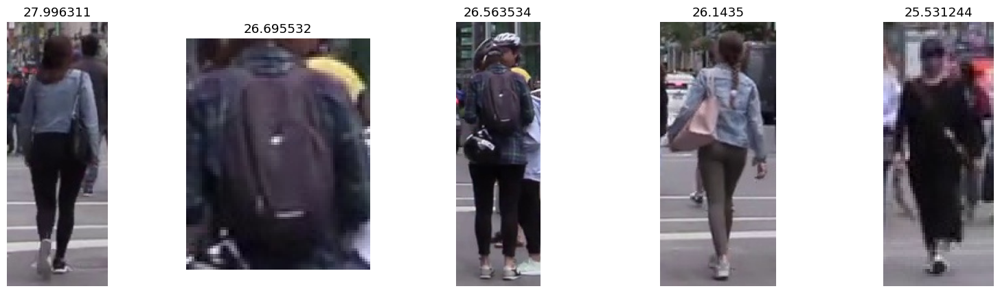

Saved 1 image to YOLO\frame660
Saved results to YOLO\frame660



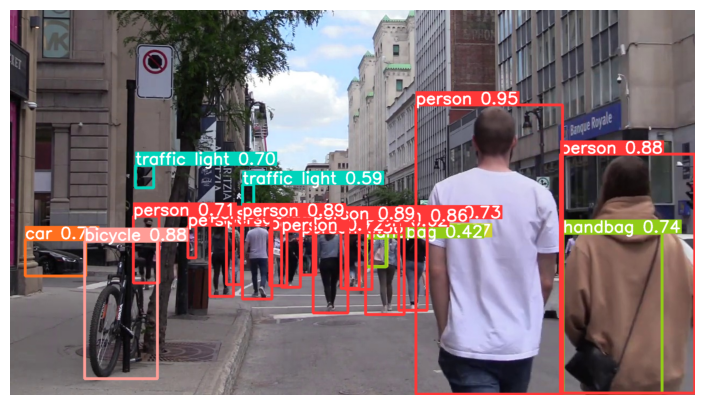

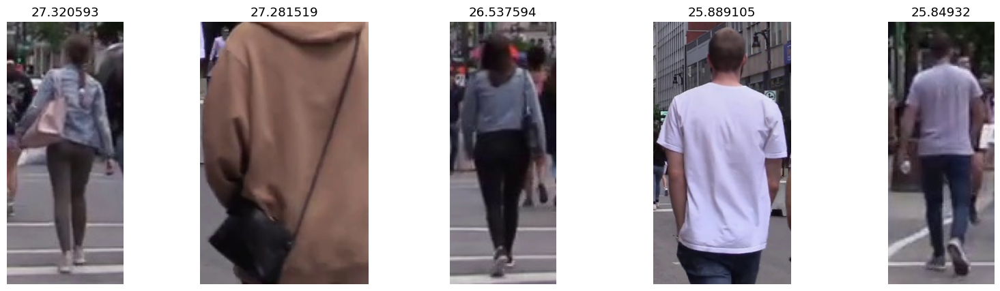

In [35]:
folder_path="moreFrames"

for filename in os.listdir(folder_path):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(folder_path, filename)
        pipeline(image_path, 'human with red bag')

Saved 1 image to YOLO\frame1202
Saved results to YOLO\frame1202



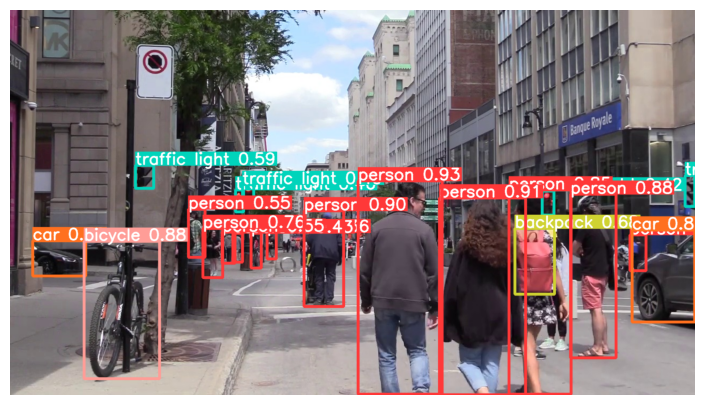

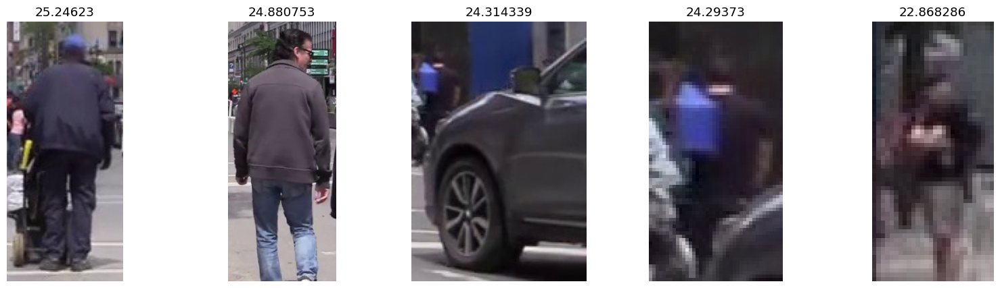

Saved 1 image to YOLO\frame1802
Saved results to YOLO\frame1802



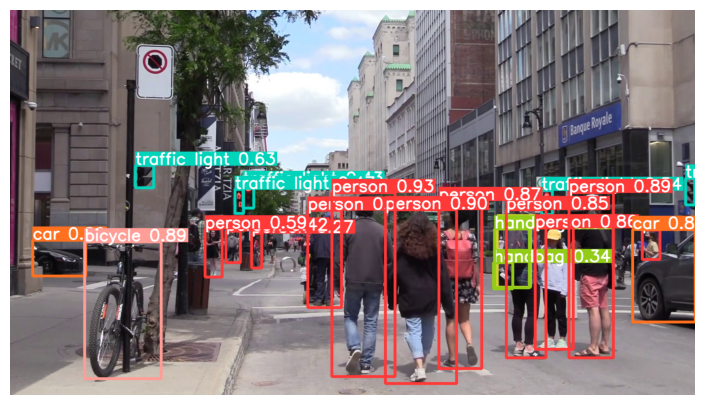

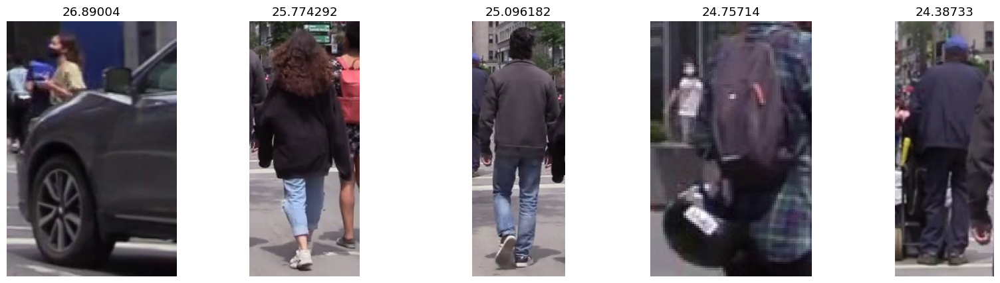

Saved 1 image to YOLO\frame2402
Saved results to YOLO\frame2402



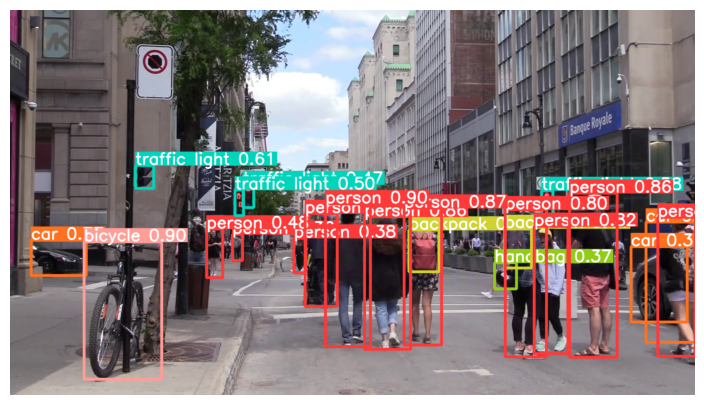

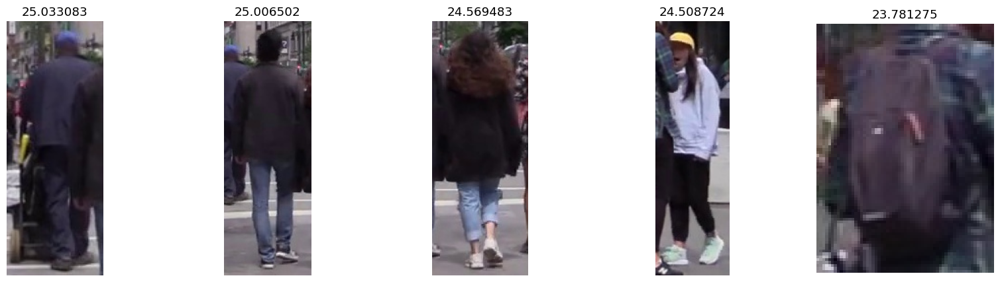

Saved 1 image to YOLO\frame3002
Saved results to YOLO\frame3002



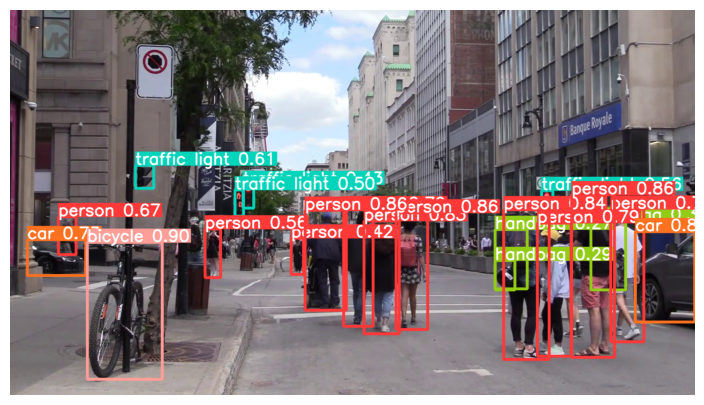

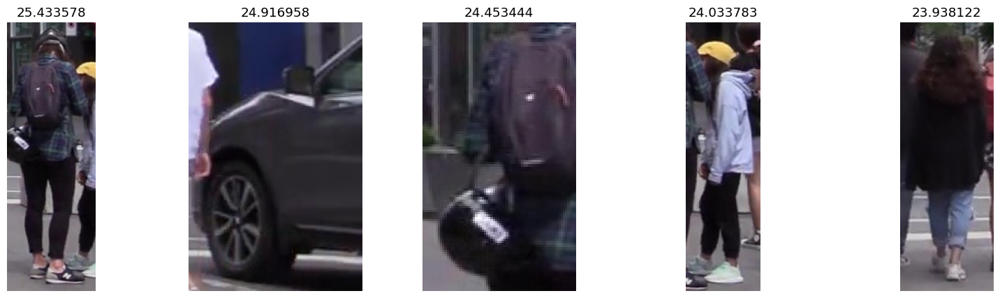

Saved 1 image to YOLO\frame3602
Saved results to YOLO\frame3602



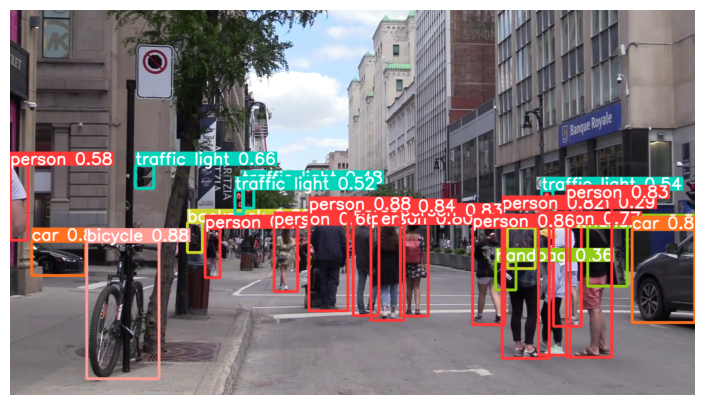

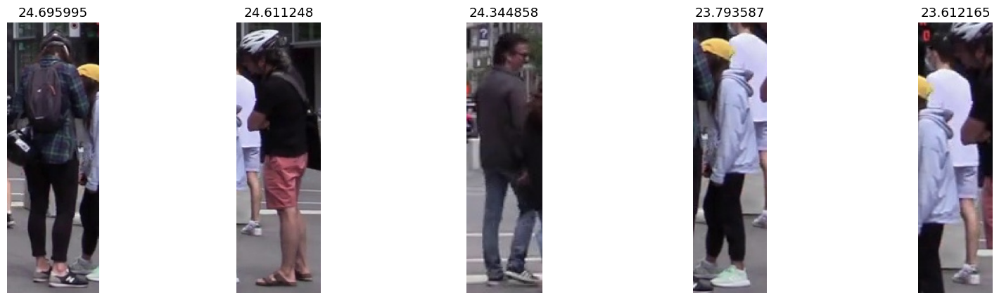

Saved 1 image to YOLO\frame4202
Saved results to YOLO\frame4202



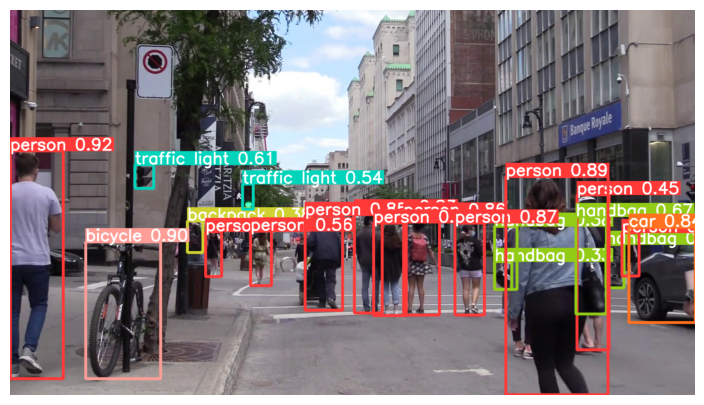

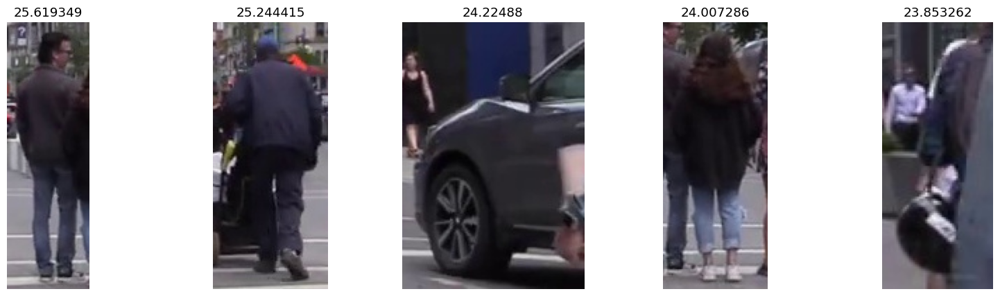

Saved 1 image to YOLO\frame4802
Saved results to YOLO\frame4802



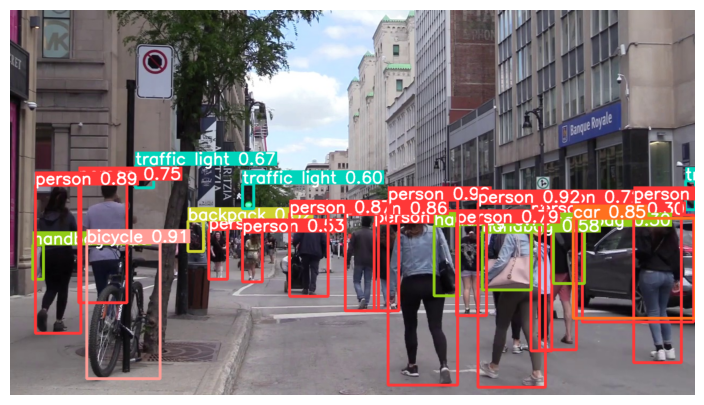

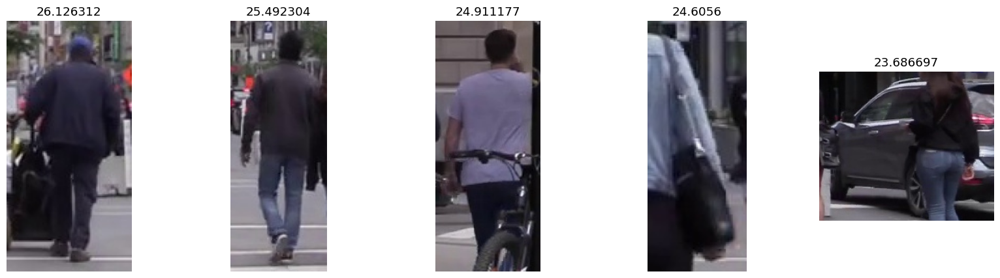

Saved 1 image to YOLO\frame5402
Saved results to YOLO\frame5402



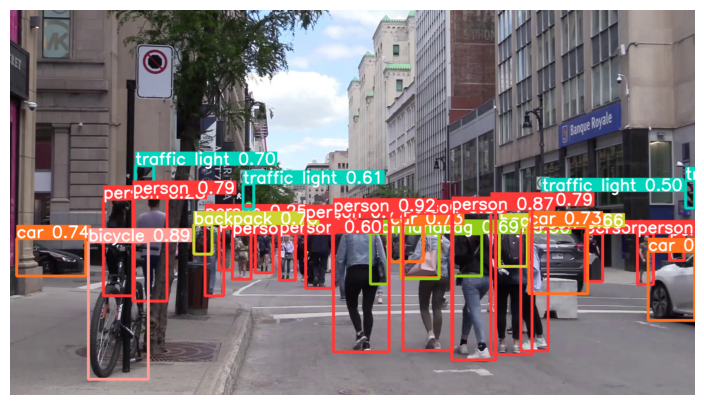

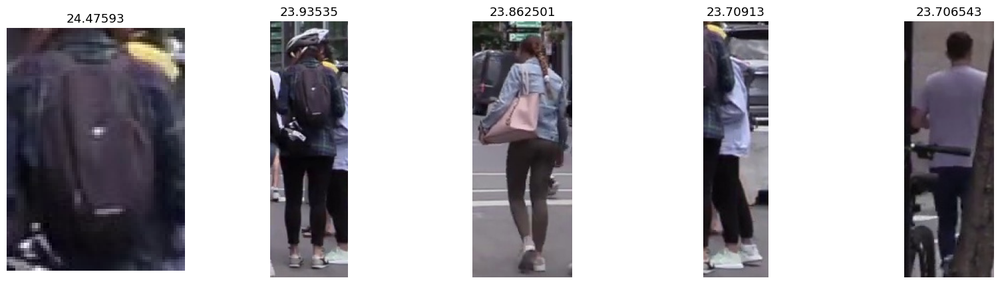

Saved 1 image to YOLO\frame602
Saved results to YOLO\frame602



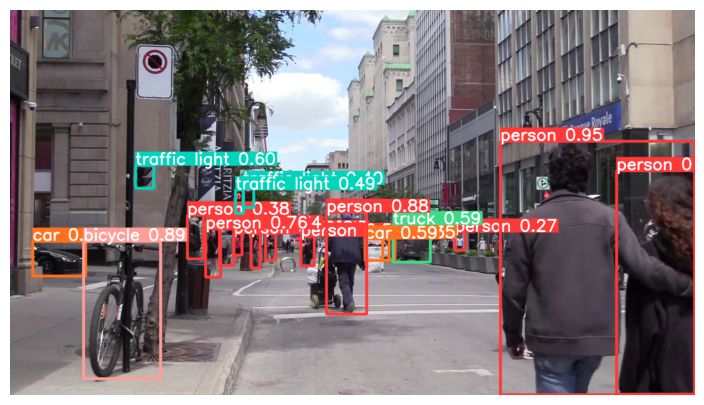

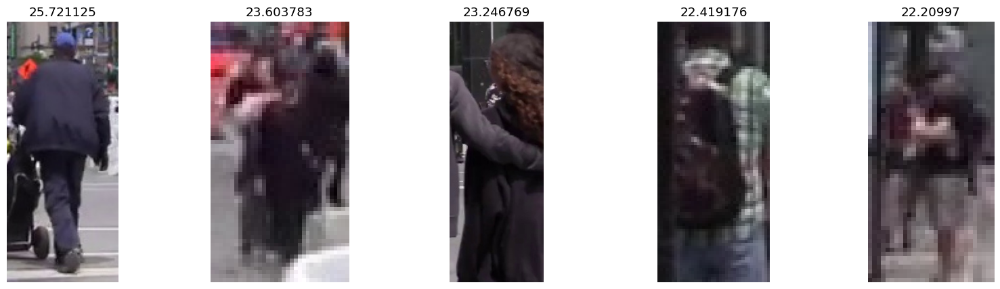

Saved 1 image to YOLO\frame6002
Saved results to YOLO\frame6002



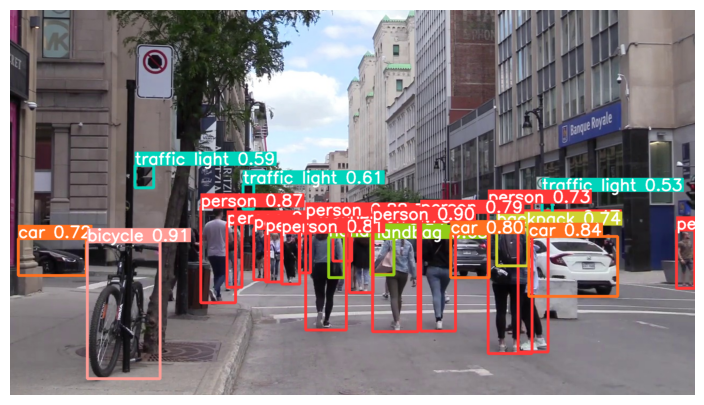

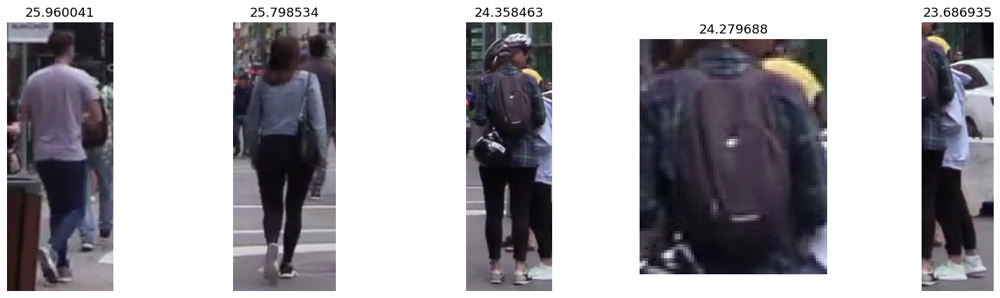

Saved 1 image to YOLO\frame6602
Saved results to YOLO\frame6602



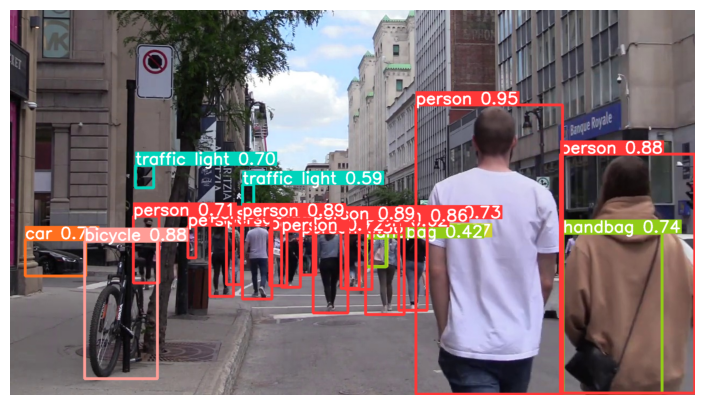

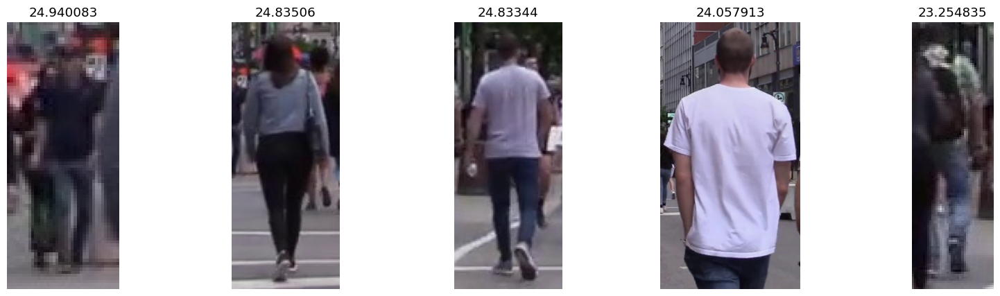

In [36]:
folder_path="moreFrames"

for filename in os.listdir(folder_path):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(folder_path, filename)
        pipeline(image_path, 'human with blue cap')